In [4]:
import pickle
import numpy as np
import matplotlib.pylab as plt


def plot_agent_reward(rewards):
    """Function to plot agent's accumulated reward vs. iteration"""
    plt.plot(np.cumsum(rewards))
    plt.title("Agent Cumulative Reward vs. Iteration")
    plt.ylabel("Reward")
    plt.xlabel("Episode")
    plt.show()


In [ ]:
with open('./agent.pkl', 'rb') as f:
    agent = pickle.load(f)

plot_agent_reward(agent.rewards)

第1輪遊戲
    0   1   2

0   X   O   X   

1   O   O   X   

2   X   O   O   

agent 2 wins!
第2輪遊戲
    0   1   2

0   X   X   X   

1   O   X   O   

2   -   O   -   

agent 1 wins!
第3輪遊戲
    0   1   2

0   X   O   X   

1   O   O   O   

2   X   X   O   

agent 2 wins!
第4輪遊戲
    0   1   2

0   X   O   X   

1   X   O   -   

2   O   O   X   

agent 2 wins!
第5輪遊戲
    0   1   2

0   X   O   O   

1   O   X   -   

2   -   -   X   

agent 1 wins!
第6輪遊戲
    0   1   2

0   O   O   X   

1   X   X   O   

2   O   X   X   

It's a draw!
第7輪遊戲
    0   1   2

0   O   -   X   

1   X   O   -   

2   -   -   O   

agent 2 wins!
第8輪遊戲
    0   1   2

0   X   X   O   

1   O   O   -   

2   O   X   X   

agent 2 wins!
第9輪遊戲
    0   1   2

0   O   X   O   

1   X   X   O   

2   X   O   O   

agent 2 wins!
第10輪遊戲
    0   1   2

0   O   X   X   

1   O   X   X   

2   O   -   O   

agent 2 wins!
第11輪遊戲
    0   1   2

0   X   X   -   

1   O   X   -   

2   O   O   O   

agent 2 wins!
第12輪遊戲
    0   1   2

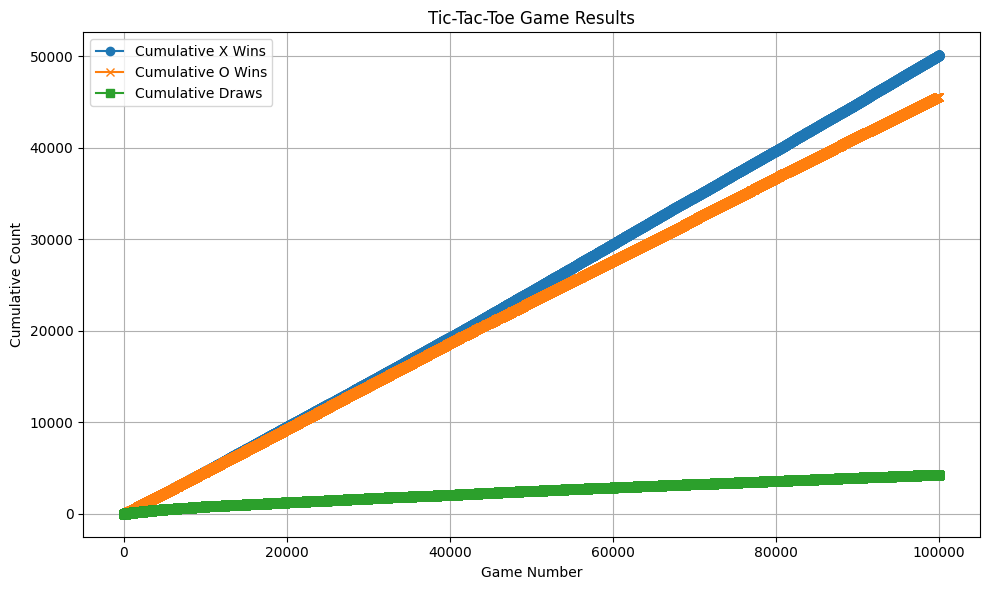

In [15]:
from abc import ABC, abstractmethod
import os
import pickle
import collections
import numpy as np
import random
import matplotlib.pyplot as plt


class Learner(ABC):
    """
    Parent class for Q-learning and SARSA agents.

    Parameters
    ----------
    alpha : float
        learning rate
    gamma : float
        temporal discounting rate
    eps : float
        probability of random action vs. greedy action
    eps_decay : float
        epsilon decay rate. Larger value = more decay
    """

    def __init__(self, alpha, gamma, eps, eps_decay=0.0):
        # Agent parameters
        self.alpha = alpha
        self.gamma = gamma
        self.eps = eps
        self.eps_decay = eps_decay
        # Possible actions correspond to the set of all x,y coordinate pairs
        self.actions = []
        for i in range(3):
            for j in range(3):
                self.actions.append((i, j))
        # Initialize Q values to 0 for all state-action pairs.
        # Access value for action a, state s via Q[a][s]
        self.Q = {}
        for action in self.actions:
            self.Q[action] = collections.defaultdict(int)
        # Keep a list of reward received at each episode
        self.rewards = []

    def get_action(self, s):
        """
        Select an action given the current game state.

        Parameters
        ----------
        s : string
            state
        """
        # Only consider the allowed actions (empty board spaces)
        possible_actions = [a for a in self.actions if s[a[0] * 3 + a[1]] == "-"]
        if random.random() < self.eps:
            # Random choose.
            action = possible_actions[random.randint(0, len(possible_actions) - 1)]
        else:
            # Greedy choose.
            values = np.array([self.Q[a][s] for a in possible_actions])
            # Find location of max
            ix_max = np.where(values == np.max(values))[0]
            if len(ix_max) > 1:
                # If multiple actions were max, then sample from them
                ix_select = np.random.choice(ix_max, 1)[0]
            else:
                # If unique max action, select that one
                ix_select = ix_max[0]
            action = possible_actions[ix_select]

        # update epsilon; geometric decay
        self.eps *= 1.0 - self.eps_decay

        return action

    def save(self, path):
        """Pickle the agent object instance to save the agent's state."""
        if os.path.isfile(path):
            os.remove(path)
        f = open(path, "wb")
        pickle.dump(self, f)
        f.close()

    @abstractmethod
    def update(self, s, s_, a, a_, r):
        pass


class SARSAlearner(Learner):
    """
    A class to implement the SARSA agent.
    """

    def __init__(self, alpha, gamma, eps, eps_decay=0.0):
        super().__init__(alpha, gamma, eps, eps_decay)

    def update(self, s, s_, a, a_, r):
        """
        Perform the SARSA update of Q values.

        Parameters
        ----------
        s : string
            previous state
        s_ : string
            new state
        a : (i,j) tuple
            previous action
        a_ : (i,j) tuple
            new action
        r : int
            reward received after executing action "a" in state "s"
        """
        # Update Q(s,a)
        if s_ is not None:
            self.Q[a][s] += self.alpha * (
                r + self.gamma * self.Q[a_][s_] - self.Q[a][s]
            )
        else:
            # terminal state update
            self.Q[a][s] += self.alpha * (r - self.Q[a][s])

        # add r to rewards list
        self.rewards.append(r)


class Game:
    """The game class. New instance created for each new game."""

    def __init__(self, agent1, agent2, teacher=None):
        self.agent1 = agent1
        self.agent2 = agent2
        self.teacher = teacher
        # initialize the game board
        self.board = [["-", "-", "-"], ["-", "-", "-"], ["-", "-", "-"]]
        self.oCount = 0
        self.xCount = 0
        self.dCount = 0

    def playerMove(self):
        """
        Querry player for a move and update the board accordingly.
        """
        if self.teacher is not None:
            action = self.teacher.makeMove(self.board)
            self.board[action[0]][action[1]] = "X"
        else:
            printBoard(self.board)
            while True:
                move = input(
                    "Your move! Please select a row and column from 0-2 "
                    "in the format row,col: "
                )
                print("\n")
                try:
                    row, col = int(move[0]), int(move[2])
                except ValueError:
                    print("INVALID INPUT! Please use the correct format.")
                    continue
                if (
                    row not in range(3)
                    or col not in range(3)
                    or not self.board[row][col] == "-"
                ):
                    print("INVALID MOVE! Choose again.")
                    continue
                self.board[row][col] = "X"
                break

    def agent1Move(self, action):
        """
        Update board according to agent's move.
        """
        self.board[action[0]][action[1]] = "O"

    def agent2Move(self, action):
        self.board[action[0]][action[1]] = "X"

    def checkForWin(self, key):
        """
        Check to see whether the player/agent with token 'key' has won.
        Returns a boolean holding truth value.

        Parameters
        ----------
        key : string
            token of most recent player. Either 'O' or 'X'
        """
        # check for player win on diagonals
        a = [self.board[0][0], self.board[1][1], self.board[2][2]]
        b = [self.board[0][2], self.board[1][1], self.board[2][0]]
        if a.count(key) == 3 or b.count(key) == 3:
            return True
        # check for player win on rows/columns
        for i in range(3):
            col = [self.board[0][i], self.board[1][i], self.board[2][i]]
            row = [self.board[i][0], self.board[i][1], self.board[i][2]]
            if col.count(key) == 3 or row.count(key) == 3:
                return True
        return False

    def checkForDraw(self):
        """
        Check to see whether the game has ended in a draw. Returns a
        boolean holding truth value.
        """
        draw = True
        for row in self.board:
            for elt in row:
                if elt == "-":
                    draw = False
        return draw

    def checkForEnd(self, key):
        """
        Checks if player/agent with token 'key' has ended the game. Returns -1
        if the game is still going, 0 if it is a draw, and 1 if the player/agent
        has won.

        Parameters
        ----------
        key : string
            token of most recent player. Either 'O' or 'X'
        """
        if self.checkForWin(key):
            if self.teacher is None:
                printBoard(self.board)
                if key == "X":
                    # print("Player wins!")
                    print("agent 1 wins!")
                    self.xCount = self.xCount + 1
                else:
                    # print("RL agent wins!")
                    print("agent 2 wins!")
                    self.oCount = self.oCount + 1
            return 1
        elif self.checkForDraw():
            if self.teacher is None:
                printBoard(self.board)
                print("It's a draw!")
            self.dCount = self.dCount + 1
            return 0
        return -1

    def playGame(self, player_first, skip_learning=False):
        """
        Begin the tic-tac-toe game loop.

        Parameters
        ----------
        player_first : boolean
            Whether or not the player will move first. If False, the
            agent goes first.

        """
        prev_state = getStateKey(self.board)
        prev2_action = self.agent2.get_action(prev_state)
        # Initialize the agent's state and action
        if player_first:
            self.agent2Move(prev2_action)
        #     self.playerMove()

        # iterate until game is over
        while True:
            # Agent1's move
            prev_state = getStateKey(self.board)
            prev1_action = self.agent1.get_action(prev_state)
            self.agent1Move(prev1_action)
            check = self.checkForEnd("O")
            if not check == -1:
                reward = check
                self.agent1.update(prev_state, None, prev1_action, None, reward)
                if not skip_learning:
                    self.agent2.update(prev_state, None, prev2_action, None, -reward)
                break

            # Agent2's move
            prev_state = getStateKey(self.board)
            prev2_action = self.agent2.get_action(prev_state)
            self.agent2Move(prev2_action)
            check = self.checkForEnd("X")
            if not check == -1:
                reward = -1 * check
                self.agent1.update(prev_state, None, prev1_action, None, reward)
                if not skip_learning:
                    self.agent2.update(prev_state, None, prev2_action, None, -reward)
                break
            else:
                reward = 0

            new_state = getStateKey(self.board)
            # Agent1 updates
            new1_action = self.agent1.get_action(new_state)
            self.agent1.update(prev_state, new_state, prev1_action, new1_action, reward)
            # Agent2 updates
            new2_action = self.agent2.get_action(new_state)
            if not skip_learning:
                self.agent2.update(
                    prev_state, new_state, prev2_action, new2_action, -reward
                )
            prev_state = new_state
            prev1_action = new1_action

        # Game over. Perform final update
        self.agent1.update(prev_state, None, prev1_action, None, reward)

    def start(self):
        """
        Function to determine who moves first, and subsequently, start the game.
        If a teacher is employed, first mover is selected at random.
        If a human is playing, the human is asked whether he/she would
        like to move fist.
        """
        if self.teacher is not None:
            # During teaching, chose who goes first randomly with equal probability
            if random.random() < 0.5:
                self.playGame(player_first=False)
            else:
                self.playGame(player_first=True)
        else:
            while True:
                response = input("Would you like to go first? [y/n]: ")
                print("")
                if response == "n" or response == "no":
                    self.playGame(player_first=False)
                    break
                elif response == "y" or response == "yes":
                    self.playGame(player_first=True)
                    break
                else:
                    print("Invalid input. Please enter 'y' or 'n'.")

    def getResult(self):
        return self.oCount, self.xCount, self.dCount


def printBoard(board):
    """
    Prints the game board as text output to the terminal.

    Parameters
    ----------
    board : list of lists
        the current game board
    """
    print("    0   1   2\n")
    for i, row in enumerate(board):
        print("%i   " % i, end="")
        for elt in row:
            print("%s   " % elt, end="")
        print("\n")


def getStateKey(board):
    """
    Converts 2D list representing the board state into a string key
    for that state. Keys are used for Q-value hashing.

    Parameters
    ----------
    board : list of lists
        the current game board
    """
    key = ""
    for row in board:
        for elt in row:
            key += elt
    return key


if __name__ == "__main__":
    agent1 = SARSAlearner(alpha=0.5, gamma=0.9, eps=0.1)
    agent2 = SARSAlearner(alpha=0.5, gamma=0.9, eps=0.1)
    oCount = 0
    xCount = 0
    dCount = 0

    oCounts = []
    xCounts = []
    dCounts = []

    for i in range(100000):
        print(f"第{i+1}輪遊戲")
        game = Game(agent1, agent2)
        if i % 2 == 0:
            game.playGame(player_first=False)
            # game.playGame(player_first=False, skip_learning=(i >= 3000))
        else:
            game.playGame(player_first=True)
            # game.playGame(player_first=True, skip_learning=(i >= 3000))
        data = game.getResult()
        oCount += data[0]
        xCount += data[1]
        dCount += data[2]
        # 產生圖表
        oCounts.append(data[0])
        xCounts.append(data[1])
        dCounts.append(data[2])

    agent1.save("./agent1.pkl")
    agent2.save("./agent2.pkl")

    print("已完成互動")
    print(f"X贏{xCount}次，O贏{oCount}次，平局{dCount}次")

    results = [(xCount, oCount, dCount) for xCount, oCount, dCount in zip(xCounts, oCounts, dCounts)]

    # 計算累計次數
    cumulative_xCounts = [sum(xCounts[:i+1]) for i in range(len(xCounts))]
    cumulative_oCounts = [sum(oCounts[:i+1]) for i in range(len(oCounts))]
    cumulative_dCounts = [sum(dCounts[:i+1]) for i in range(len(dCounts))]

    # 繪製折線圖
    plt.figure(figsize=(10, 6))
    plt.plot(range(1, len(results) + 1), cumulative_xCounts, label='Cumulative X Wins', marker='o')
    plt.plot(range(1, len(results) + 1), cumulative_oCounts, label='Cumulative O Wins', marker='x')
    plt.plot(range(1, len(results) + 1), cumulative_dCounts, label='Cumulative Draws', marker='s')

    plt.title('Tic-Tac-Toe Game Results')
    plt.xlabel('Game Number')
    plt.ylabel('Cumulative Count')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()

    # 顯示圖形
    plt.show()

